NASA PACE Hackweek: FLARP

In [1]:
import os

from holoviews.streams import Tap
from matplotlib import animation
from matplotlib.colors import ListedColormap
from PIL import Image, ImageEnhance
from scipy.ndimage import gaussian_filter1d
from xarray.backends.api import open_datatree
import cartopy.crs as ccrs
import cmocean
import earthaccess
import holoviews as hv
import matplotlib.pyplot as plt
import matplotlib.pylab as pl
import numpy as np
import panel.widgets as pnw
import xarray as xr
import pandas as pd


In [2]:
file_path = "//home/jovyan/shared-public/FLARP/Data/float_profile_info.csv"
# Read the CSV file
data = pd.read_csv(file_path)#), usecols=['CRUISE', 'LON', 'LAT', 'PRES', 'CHLA', 'CHL_470', 'date'])
# Look at the data
#data

In [3]:
options = xr.set_options(display_expand_attrs=False)

In [4]:
# Find all the monthly CHL satellite data that are available
results = earthaccess.search_data(
    short_name="PACE_OCI_L3M_CHL_NRT",
    granule_name="PACE_OCI.20240701_20240731.L3m.MO.CHL.V2_0.chlor_a.0p1deg.NRT.nc",
)
paths = earthaccess.open(results)

QUEUEING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/1 [00:00<?, ?it/s]

In [5]:
dataset = xr.open_dataset(paths[0])
chla = dataset["chlor_a"]

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
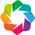

In [6]:
hv.extension("bokeh")

In [7]:
chla_plt = hv.Image(chla, kdims=["lon", "lat"]).opts(cmap='viridis',clim=(0, 1),aspect="equal", colorbar=True,frame_width=600, frame_height=300, tools=['hover'])
# Add scatter points
pts_plt = hv.Points(data, kdims = ['lon_W','LAT']).opts(fill_color='magenta', fill_alpha=1, line_width=0.5, line_color='black', size=10,tools=['hover'])

Let's look at where are float data are located!

The dots on the chlorophyll-a map below show all of your float profile locations where the new fluorescence sensor collected data.

The western North Atlantic looks interesting... there are at least 3 disctinct floats, a lot of profiles, and a good range in chlorophyll shown in the satellite image.

In [9]:
# Combine the map with the float locations
chla_plt*pts_plt

:Overlay
   .Image.I  :Image   [lon,lat]   (Chlorophyll Concentration, OCI Algorithm)
   .Points.I :Points   [lon_W,LAT]   (SDN,CRUISE,STATION,LON,date)

Let's look at some PACE data other than boring ol' chlor_a!

In [10]:
results = earthaccess.search_data(
    short_name="PACE_OCI_L3M_IOP_NRT",
    granule_name="PACE_OCI.20240501_20240531.L3m.MO.IOP.V2_0.aph.1deg.NRT.nc",
)
paths = earthaccess.open(results)
dataset = xr.open_dataset(paths[0])
dataset

QUEUEING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

PROCESSING TASKS | :   0%|          | 0/1 [00:00<?, ?it/s]

COLLECTING RESULTS | :   0%|          | 0/1 [00:00<?, ?it/s]

<xarray.Dataset> Size: 5MB
Dimensions:     (wavelength: 19, lat: 180, lon: 360, rgb: 3, eightbitcolor: 256)
Coordinates:
  * wavelength  (wavelength) float64 152B 351.0 361.0 385.0 ... 678.0 711.0
  * lat         (lat) float32 720B 89.5 88.5 87.5 86.5 ... -87.5 -88.5 -89.5
  * lon         (lon) float32 1kB -179.5 -178.5 -177.5 ... 177.5 178.5 179.5
Dimensions without coordinates: rgb, eightbitcolor
Data variables:
    aph         (lat, lon, wavelength) float32 5MB ...
    palette     (rgb, eightbitcolor) uint8 768B ...
Attributes: (64)

Example of the aph data

In [11]:
# this works, but as a function (above) it doesn't??
array = dataset.sel({"wavelength": 442})
band_dmap = hv.Image(array, kdims=["lon", "lat"]).opts(frame_width=450, frame_height=250)

In [12]:
def spectrum(x, y):
    array = dataset.sel({"lon": x, "lat": y}, method="nearest")
    return hv.Curve(array, kdims=["wavelength"]).redim.range(aph=(-0.01, 0.04))

In [13]:
spectrum(0,0)
#array = dataset.sel({"lon": 0, "lat": 0}, method="nearest")
#hv.Curve(array, kdims=["wavelength"]).redim.range(aph=(-0.01, 0.04))

:Curve   [wavelength]   (Absorption due to phytoplankton,palette)

In [14]:
# Make the map dynamic to you can select a point
points = hv.Points([])
tap = Tap(source=points, x=0, y=0)
spectrum_dmap = hv.DynamicMap(spectrum, streams=[tap])

In [15]:
# Look at the data
#flt_pts_map = hv.Point(coords)
float_points = hv.Points(data, ['lon_W', 'LAT']).opts(color='magenta', size=3, tools=['hover'], alpha=0.2)

In [16]:
# Overlay the points on the rasterized chlorophyll image
(band_dmap * float_points * points  + spectrum_dmap).opts(shared_axes=False)

:Layout
   .Overlay.I    :Overlay
      .Image.I   :Image   [lon,lat]   (Absorption due to phytoplankton,palette)
      .Points.I  :Points   [lon_W,LAT]   (SDN,CRUISE,STATION,LON,date)
      .Points.II :Points   [x,y]
   .DynamicMap.I :DynamicMap   []
      :Curve   [wavelength]   (Absorption due to phytoplankton,palette)

Get normalized spectra for the whole dataset, normalize to aph at 555nm

In [17]:
# Get the aph(555) as an np array
aph555 = dataset.sel({"wavelength": 555})
new_array = aph555['aph']
aph555_np = new_array.values
# Save a np array of aph spectral data
aph = dataset['aph']
aph_np = aph.values

# Expand dimensions of 555 data to match aph data
aph555_np_3d = np.expand_dims(aph555_np, axis=2)  
# Broadcast aph555 data across all wavelngths (19)
aph555_np_exp = np.tile(aph555_np_3d, (1, 1, 19))  

# Divide aph by aph(555)
# Use numpy's error handling to manage division by zero
with np.errstate(divide='ignore', invalid='ignore'):
    naph = np.divide(aph_np, aph555_np_exp)
# Replace infinities or NaNs with a specific value
naph[np.isinf(naph)] = np.nan  # Replace infinities with NaN

# Add the normalized apg data as a new variable to the dataset
dataset['naph'] = (['lat', 'lon','wavelength'], naph)

# Add ratio of n435 to n475
aph425 = dataset['naph'].sel({"wavelength": 425})
new_array = aph425
aph425_np = new_array.values

aph475 = dataset['naph'].sel({"wavelength": 475})
new_array = aph475
aph475_np = new_array.values


In [18]:
# Check that the normalization at 55 worked correctly, should create a map all of the same color
array = dataset['naph'].sel({"wavelength": 555})
#naph_dmap = hv.Image(array, kdims=["lon", "lat"]).opts(frame_width=450, frame_height=250)
#hv.Image(array, kdims=["lon", "lat"]).opts(frame_width=450, frame_height=250)

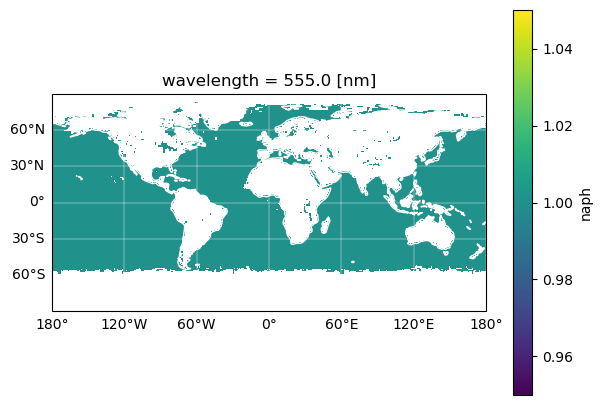

In [19]:
#pts_plt = hv.Points(data, kdims = ['lon_W','LAT']).opts(fill_color='magenta', fill_alpha=1, line_width=0.5, line_color='black', size=10,tools=['hover'])
fig = plt.figure(figsize=(7, 5))
ax = plt.axes(projection=ccrs.PlateCarree())

artist = array.plot(cmap='viridis',ax=ax,clim=(0.8, 1.1))

ax.gridlines(draw_labels={"left": "y", "bottom": "x"}, color="white", linewidth=0.3)
ax.coastlines(color="white", linewidth=1)


In [20]:
# Take ratio of aph at n425 to n475
R = aph425_np / aph475_np
# Save ratio to dataset
dataset['R'] = (['lat', 'lon'], R)

In [21]:
# Set the plot for the float profiles
file_path = "//home/jovyan/shared-public/FLARP/float_profile_info_na_final.csv"
# Read the CSV file
data = pd.read_csv(file_path)#), usecols=['CRUISE', 'LON', 'LAT', 'PRES', 'CHLA', 'CHL_470', 'date'])
# Make variable for the float 435:470 data
Rfl = data.Chl435 / data.Chl470

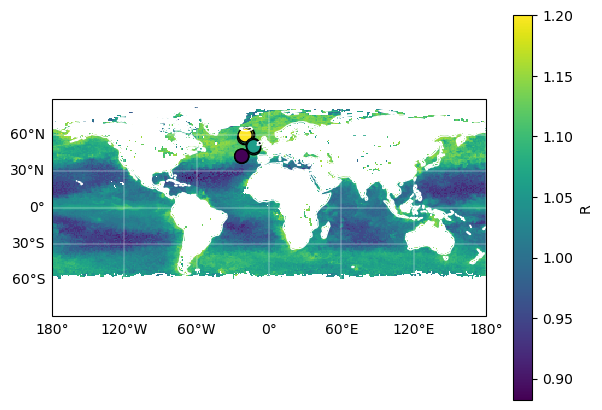

In [22]:
#pts_plt = hv.Points(data, kdims = ['lon_W','LAT']).opts(fill_color='magenta', fill_alpha=1, line_width=0.5, line_color='black', size=10,tools=['hover'])
fig = plt.figure(figsize=(7, 5))
ax = plt.axes(projection=ccrs.PlateCarree())

Rarray = dataset['R']
artist = Rarray.plot(cmap='viridis',ax=ax,clim=(0.8, 1.1))

# Add dots on map for float locations
ax.scatter(data.lon_W, data.LAT, c=Rfl, cmap='viridis', s=100, edgecolor='k', alpha=1, transform=ccrs.PlateCarree())

ax.gridlines(draw_labels={"left": "y", "bottom": "x"}, color="white", linewidth=0.3)
ax.coastlines(color="white", linewidth=1)


Read in the subset float dataset that includes the satellite estimated chl, and optical-depth avgs

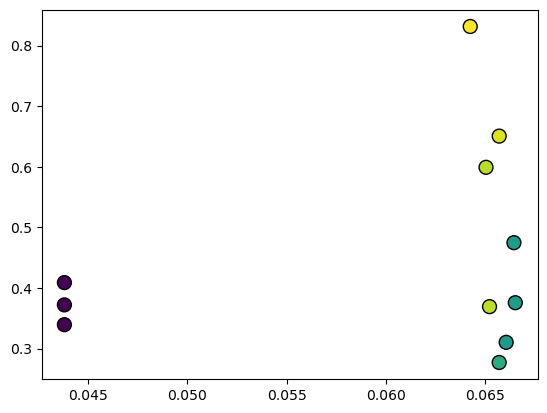

In [23]:
# Compare each fluor sensor to PACE CHL
scatter1 = plt.scatter(data.Chl435, data.Chla_PACE, c=Rfl, cmap='viridis', s=100, edgecolor='k', alpha=1)


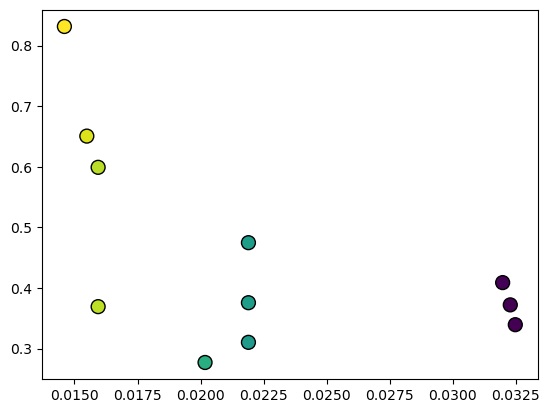

In [24]:
# Compare each fluor sensor to PACE CHL
scatter2 = plt.scatter(data.Chl470, data.Chla_PACE, c=Rfl, cmap='viridis', s=100, edgecolor='k', alpha=1)
#scatter = plt.scatter(x, y, c=colors, cmap='viridis', s=100, edgecolor='k', alpha=0.7)

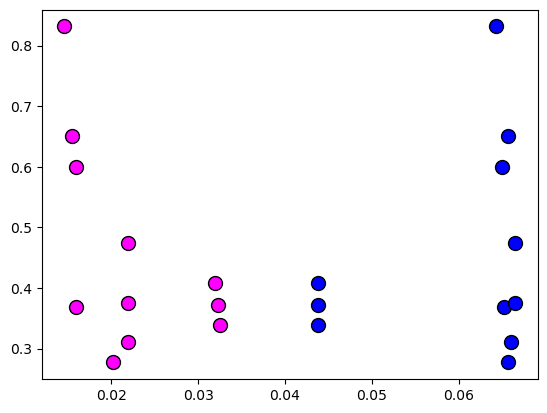

In [25]:
# Compare each fluor sensor to PACE CHL
scatter2 = plt.scatter(data.Chl470, data.Chla_PACE, color='magenta', s=100, edgecolor='k', alpha=1)
scatter1 = plt.scatter(data.Chl435, data.Chla_PACE, color='blue', s=100, edgecolor='k', alpha=1)
